# Novel view synthesis with NeRF: Training and Testing on Colab

If you're running this on Colab, insert the following Javascript snippet into your browser console so that your Colab runtime won't time out. Open developer-settings (in your web-browser) with Ctrl+Shift+I then click on console tab and type this on the console prompt. (for mac press Option+Command+I)

(You can ignore this if you manually click connect button.)
```Javascript
function ClickConnect(){
    console.log("Clicked on connect button");
    document.querySelector("colab-connect-button").click()
}
setInterval(ClickConnect,60000)
```

In [1]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time

device_type = (
    "cuda" if torch.cuda.is_available() else
    "mps" if torch.backends.mps.is_available() else
    "cpu"
)
device = torch.device(device_type)
print(device)

%load_ext autoreload
%autoreload 2

cuda


In [2]:
!unzip cv_proj6_colab.zip -d cv_proj6
os.chdir('cv_proj6')
!pip install -e .

Archive:  cv_proj6_colab.zip
   creating: cv_proj6/src/
   creating: cv_proj6/tests/
  inflating: cv_proj6/lego_data_update.npz  
  inflating: cv_proj6/pyproject.toml  
  inflating: cv_proj6/setup.cfg      
   creating: cv_proj6/tests/__pycache__/
   creating: cv_proj6/tests/data/
  inflating: cv_proj6/tests/.DS_Store  
  inflating: cv_proj6/tests/test_part2.py  
  inflating: cv_proj6/tests/__init__.py  
  inflating: cv_proj6/tests/test_part1.py  
  inflating: cv_proj6/tests/__pycache__/test_part1.cpython-310.pyc  
  inflating: cv_proj6/tests/__pycache__/test_part2.cpython-310.pyc  
  inflating: cv_proj6/tests/__pycache__/__init__.cpython-310.pyc  
  inflating: cv_proj6/tests/data/get_rays_test_0.npz  
  inflating: cv_proj6/tests/data/compute_composit_weights_test_0.npz  
  inflating: cv_proj6/tests/data/positional_encoding_test_1.npz  
  inflating: cv_proj6/tests/data/positional_encoding_test_0.npz  
  inflating: cv_proj6/tests/data/sample_points_from_rays_test_0.npz  
  inflating: cv

# Part3 Train NeRF on 360 scene
If you passed all tests, you can start training NeRF!
Expect to reach PSNR greater than or equal to 20 after training for 1,000 iterations with num_encoding_functions=6.

Small note: The training can get stuck at local optimum with certain initialization, in which can the PSNR will not improve with more training. You can rerun the code to restart training. Training 2000 steps takes ~20 mins using T4.

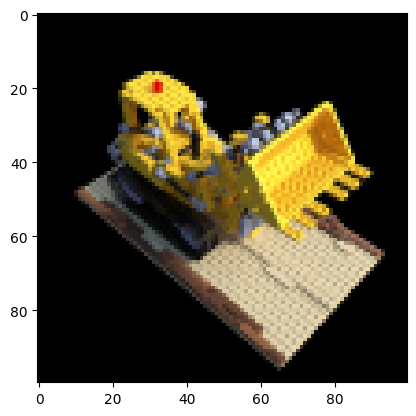

In [3]:
# Load input images, poses, and intrinsics
data = np.load("lego_data_update.npz")

# Images
images = data["images"]

# Height and width of each image
height, width = images.shape[1:3]

# Camera extrinsics (poses)
tform_cam2world = data["poses"]
tform_cam2world = torch.from_numpy(tform_cam2world).to(device)

# Camera intrinsics
cam_intrinsics = data["intrinsics"]
cam_intrinsics = torch.from_numpy(cam_intrinsics).to(device)

# Near and far clipping thresholds for depth values.
near_thresh = 0.667
far_thresh = 2.

# Hold one image out (for test).
testimg, testpose = images[101], tform_cam2world[101]
testimg = torch.from_numpy(testimg).to(device)

# Rest images form test set
testset, testsetpose = images[101:], tform_cam2world[101:]
testset = torch.from_numpy(testset).to(device)

# Map images to device
images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(testimg.detach().cpu().numpy())
plt.show()

Iteration 0 | Loss: 0.0619 | PSNR: 7.23 | Time per iter: 0.10s | Total time: 0.04 min
PSNR imrpoved from 0 to 7.231171131134033
Saving model to nerf_model.pth


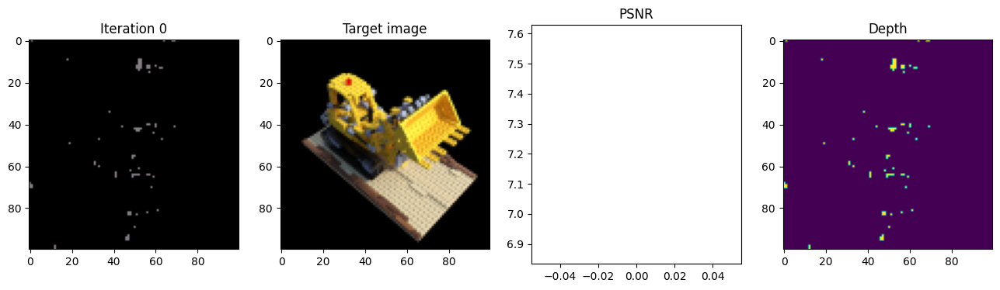

Iteration 25 | Loss: 0.0727 | PSNR: 10.44 | Time per iter: 0.33s | Total time: 0.18 min
PSNR imrpoved from 7.231171131134033 to 10.443683624267578
Saving model to nerf_model.pth


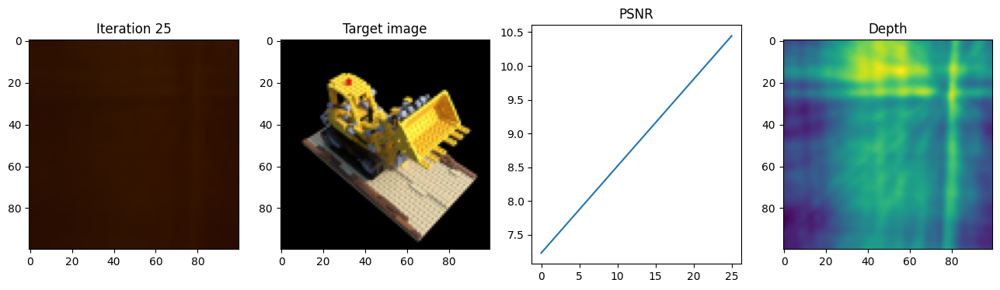

Iteration 50 | Loss: 0.0741 | PSNR: 10.75 | Time per iter: 0.33s | Total time: 0.32 min
PSNR imrpoved from 10.443683624267578 to 10.748449325561523
Saving model to nerf_model.pth


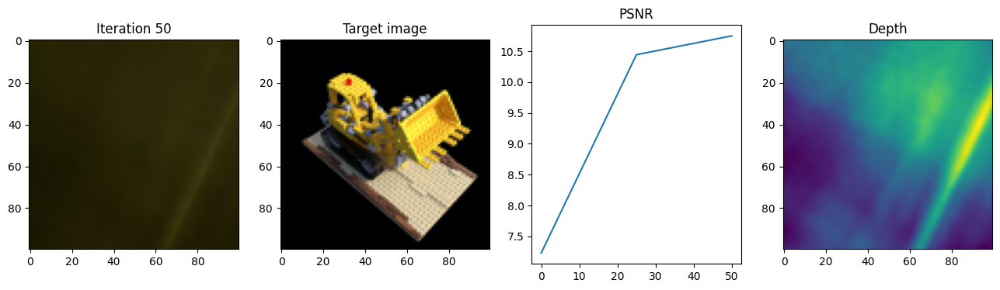

Iteration 75 | Loss: 0.0813 | PSNR: 11.09 | Time per iter: 0.33s | Total time: 0.46 min
PSNR imrpoved from 10.748449325561523 to 11.090110778808594
Saving model to nerf_model.pth


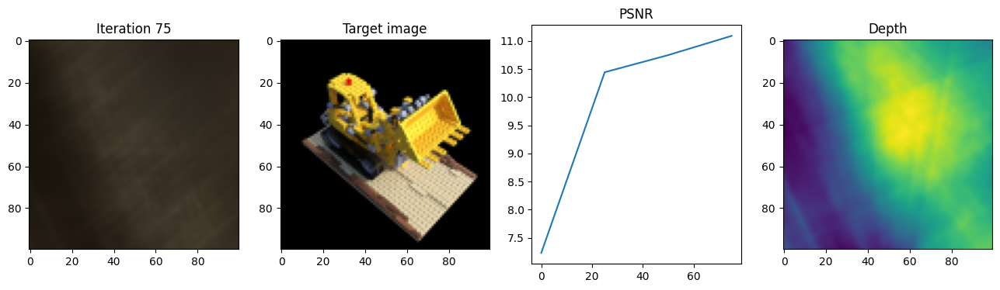

Iteration 100 | Loss: 0.0384 | PSNR: 11.73 | Time per iter: 0.34s | Total time: 0.60 min
PSNR imrpoved from 11.090110778808594 to 11.726655960083008
Saving model to nerf_model.pth


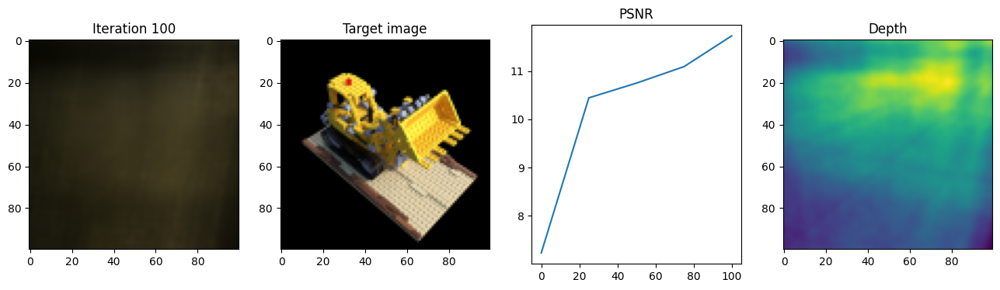

Iteration 125 | Loss: 0.0171 | PSNR: 14.53 | Time per iter: 0.34s | Total time: 0.74 min
PSNR imrpoved from 11.726655960083008 to 14.526296615600586
Saving model to nerf_model.pth


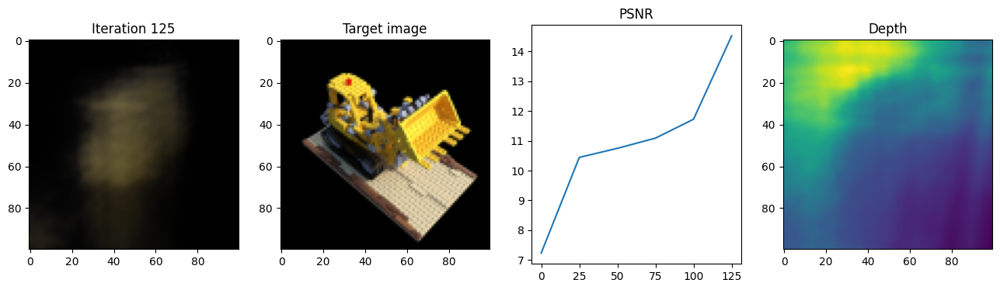

Iteration 150 | Loss: 0.0206 | PSNR: 15.34 | Time per iter: 0.34s | Total time: 0.88 min
PSNR imrpoved from 14.526296615600586 to 15.342569351196289
Saving model to nerf_model.pth


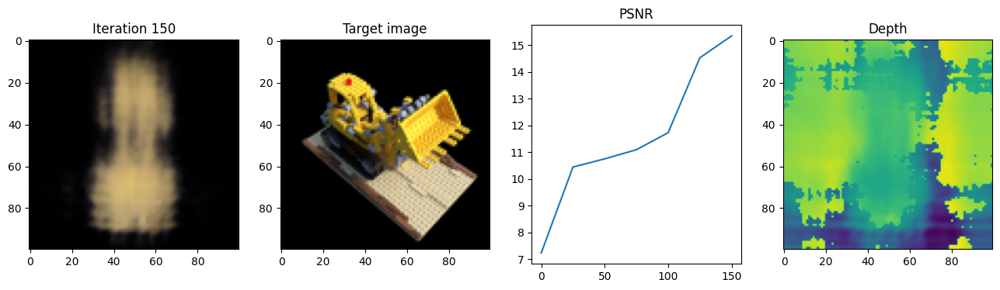

Iteration 175 | Loss: 0.0237 | PSNR: 17.14 | Time per iter: 0.35s | Total time: 1.03 min
PSNR imrpoved from 15.342569351196289 to 17.14134979248047
Saving model to nerf_model.pth


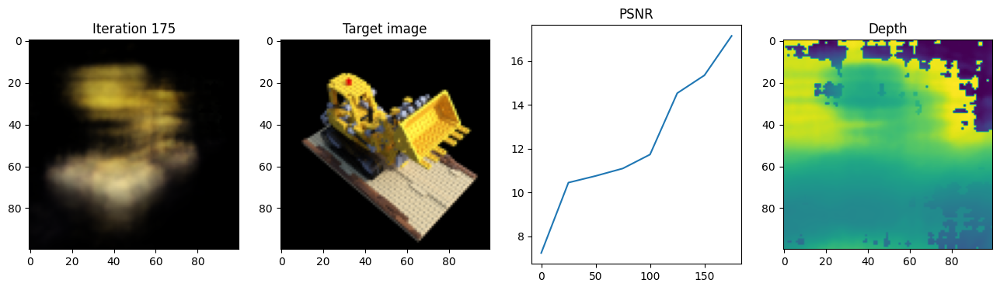

Iteration 200 | Loss: 0.0149 | PSNR: 17.86 | Time per iter: 0.34s | Total time: 1.17 min
PSNR imrpoved from 17.14134979248047 to 17.86328887939453
Saving model to nerf_model.pth


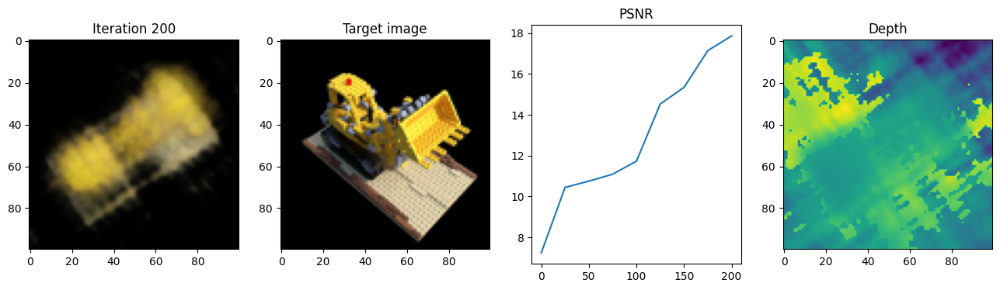

Iteration 225 | Loss: 0.0188 | PSNR: 18.44 | Time per iter: 0.34s | Total time: 1.31 min
PSNR imrpoved from 17.86328887939453 to 18.44338035583496
Saving model to nerf_model.pth


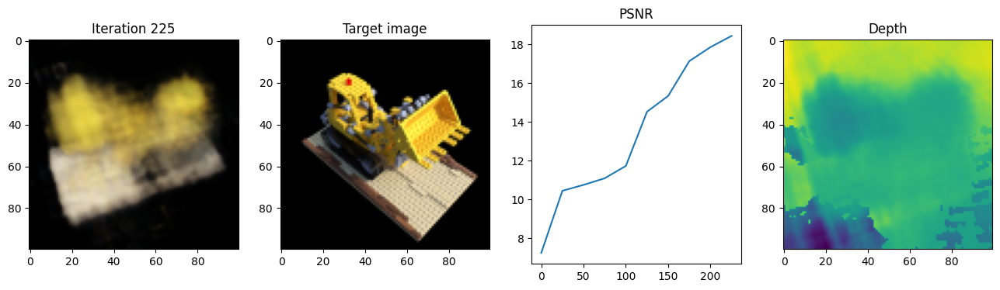

Iteration 250 | Loss: 0.0118 | PSNR: 18.37 | Time per iter: 0.35s | Total time: 1.46 min


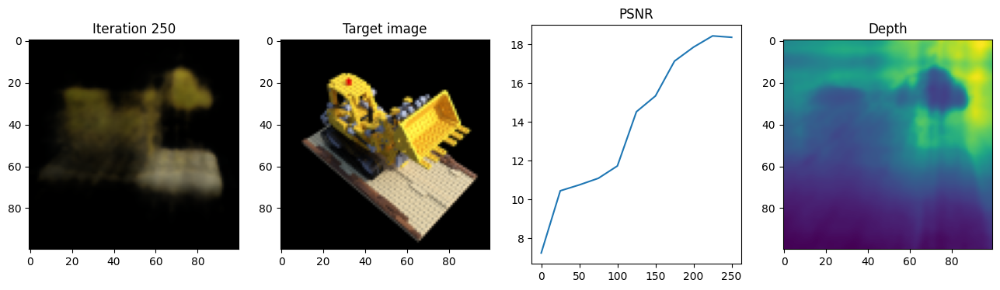

Iteration 275 | Loss: 0.0123 | PSNR: 19.03 | Time per iter: 0.35s | Total time: 1.60 min
PSNR imrpoved from 18.44338035583496 to 19.027156829833984
Saving model to nerf_model.pth


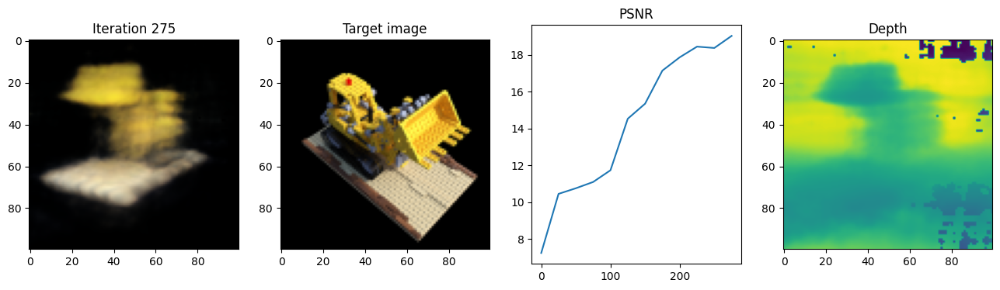

Iteration 300 | Loss: 0.0166 | PSNR: 19.20 | Time per iter: 0.35s | Total time: 1.75 min
PSNR imrpoved from 19.027156829833984 to 19.20076560974121
Saving model to nerf_model.pth


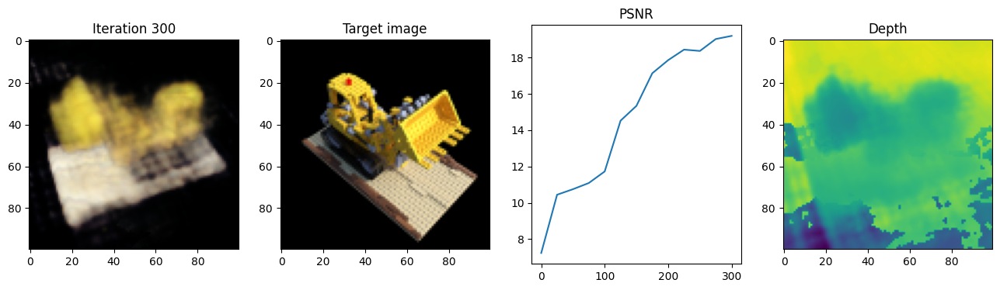

Iteration 325 | Loss: 0.0125 | PSNR: 18.81 | Time per iter: 0.35s | Total time: 1.90 min


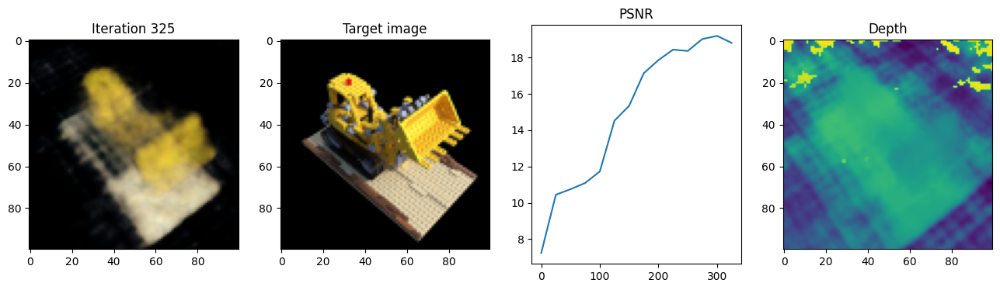

Iteration 350 | Loss: 0.0111 | PSNR: 19.15 | Time per iter: 0.34s | Total time: 2.04 min


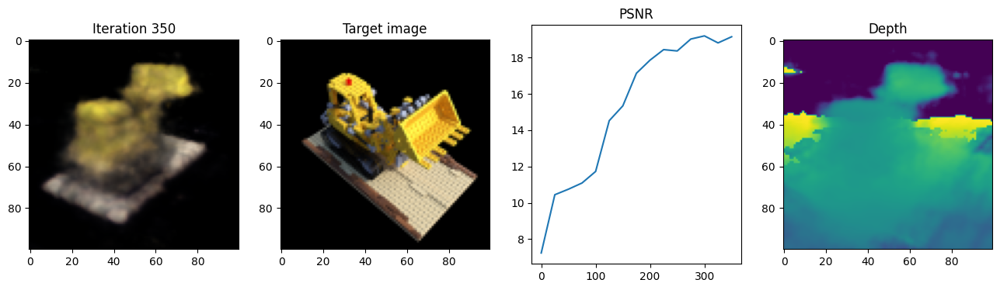

Iteration 375 | Loss: 0.0052 | PSNR: 20.09 | Time per iter: 0.34s | Total time: 2.18 min
PSNR imrpoved from 19.20076560974121 to 20.091943740844727
Saving model to nerf_model.pth


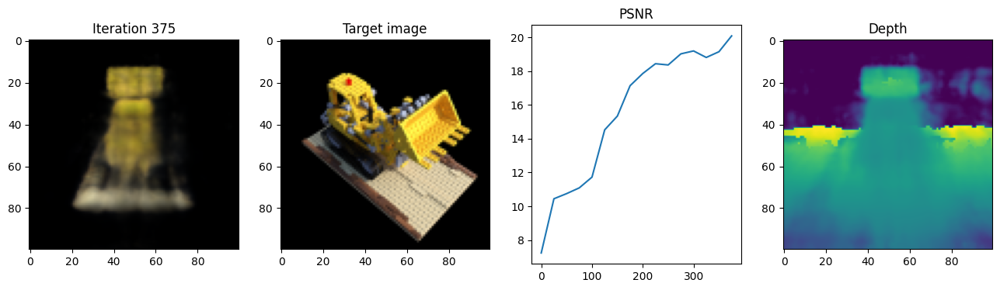

Iteration 400 | Loss: 0.0099 | PSNR: 20.37 | Time per iter: 0.34s | Total time: 2.32 min
PSNR imrpoved from 20.091943740844727 to 20.36910629272461
Saving model to nerf_model.pth


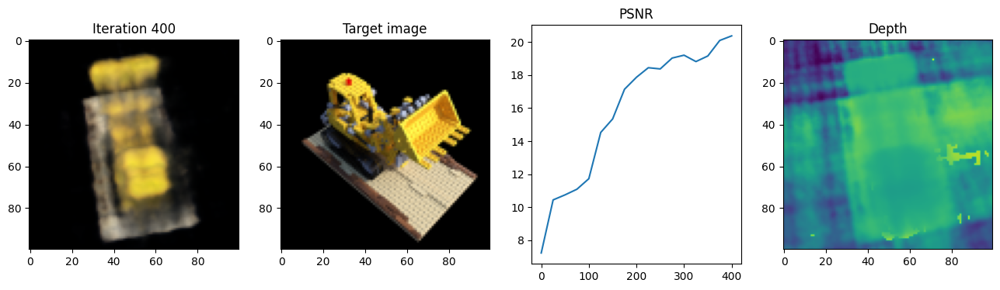

Iteration 425 | Loss: 0.0116 | PSNR: 20.36 | Time per iter: 0.33s | Total time: 2.46 min


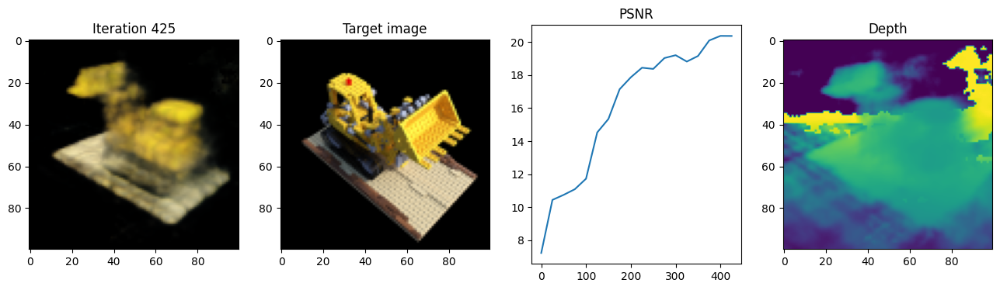

Iteration 450 | Loss: 0.0039 | PSNR: 20.47 | Time per iter: 0.33s | Total time: 2.60 min
PSNR imrpoved from 20.36910629272461 to 20.465166091918945
Saving model to nerf_model.pth


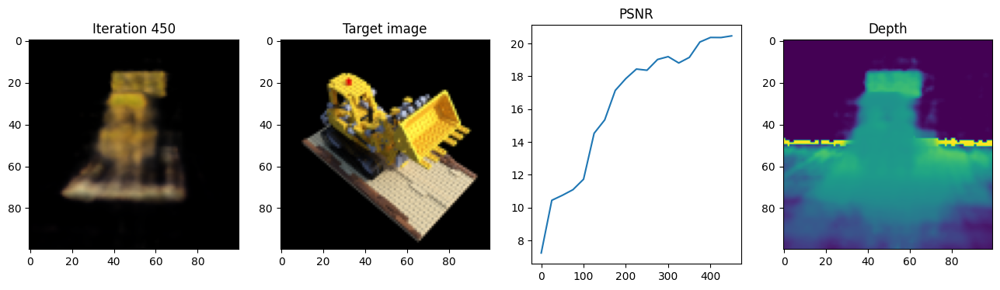

Iteration 475 | Loss: 0.0097 | PSNR: 20.40 | Time per iter: 0.33s | Total time: 2.74 min


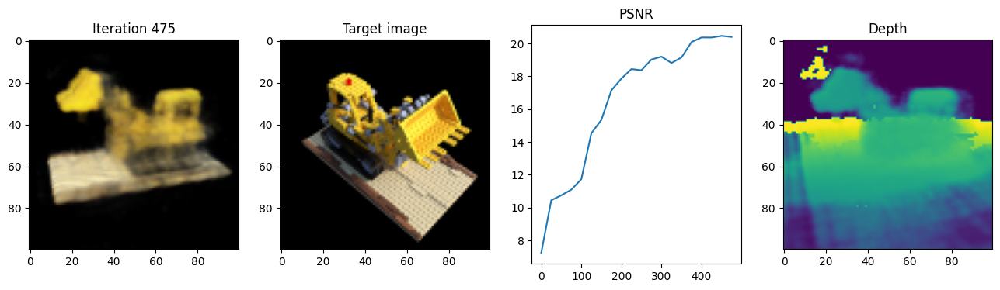

Iteration 500 | Loss: 0.0071 | PSNR: 20.77 | Time per iter: 0.34s | Total time: 2.88 min
PSNR imrpoved from 20.465166091918945 to 20.766315460205078
Saving model to nerf_model.pth


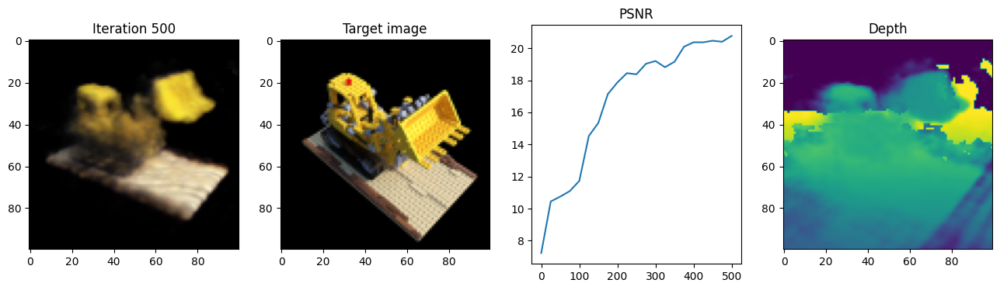

Iteration 525 | Loss: 0.0104 | PSNR: 20.41 | Time per iter: 0.34s | Total time: 3.02 min


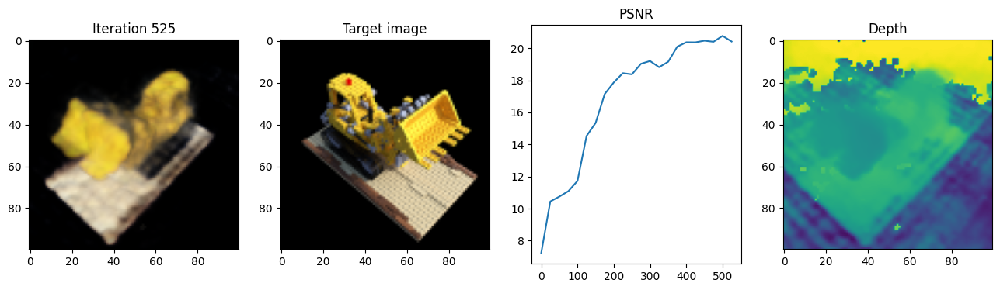

Iteration 550 | Loss: 0.0099 | PSNR: 20.84 | Time per iter: 0.34s | Total time: 3.16 min
PSNR imrpoved from 20.766315460205078 to 20.84039878845215
Saving model to nerf_model.pth


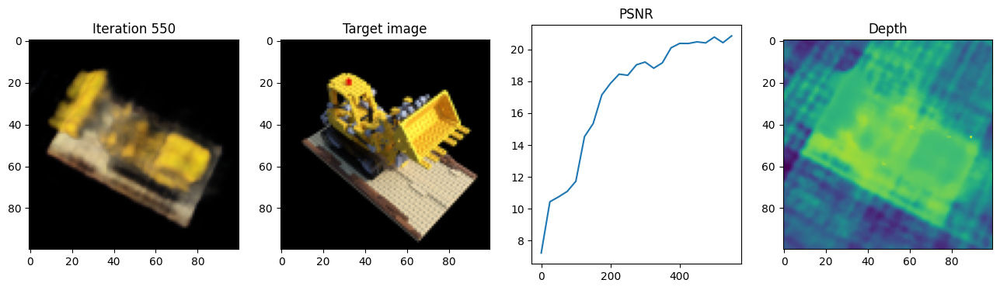

Iteration 575 | Loss: 0.0060 | PSNR: 20.69 | Time per iter: 0.34s | Total time: 3.30 min


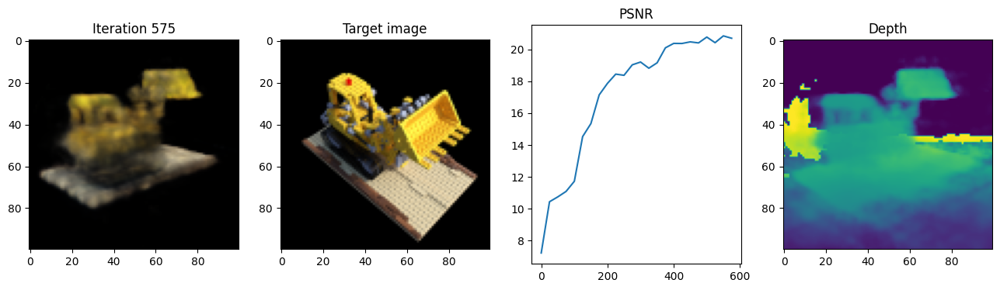

Iteration 600 | Loss: 0.0055 | PSNR: 20.70 | Time per iter: 0.33s | Total time: 3.44 min


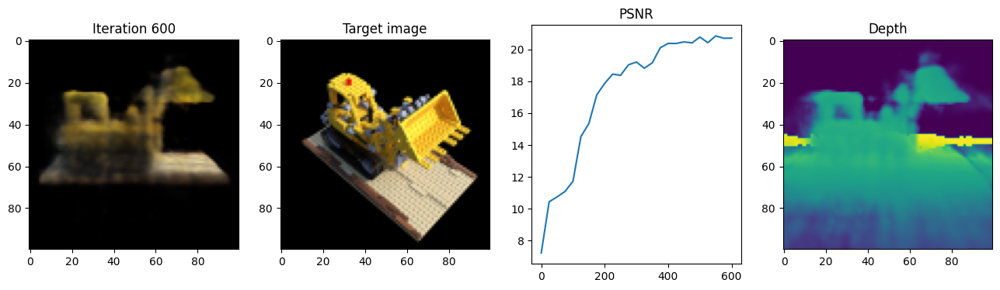

Iteration 625 | Loss: 0.0088 | PSNR: 20.87 | Time per iter: 0.33s | Total time: 3.58 min
PSNR imrpoved from 20.84039878845215 to 20.86665916442871
Saving model to nerf_model.pth


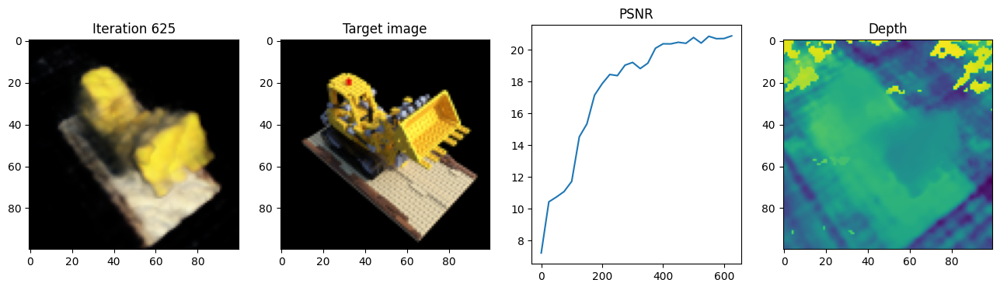

Iteration 650 | Loss: 0.0071 | PSNR: 20.81 | Time per iter: 0.34s | Total time: 3.72 min


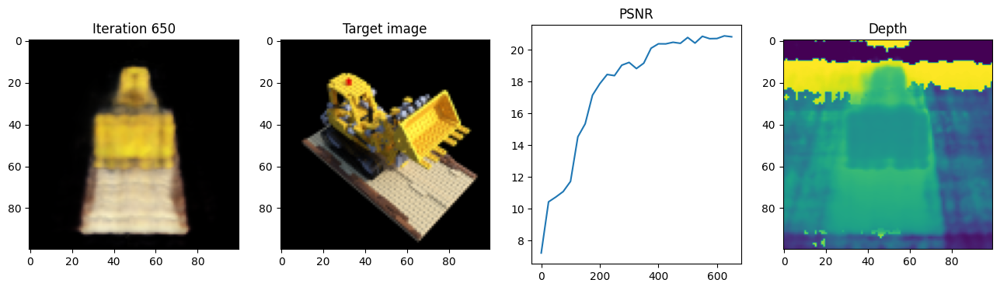

Iteration 675 | Loss: 0.0081 | PSNR: 21.48 | Time per iter: 0.34s | Total time: 3.86 min
PSNR imrpoved from 20.86665916442871 to 21.480215072631836
Saving model to nerf_model.pth


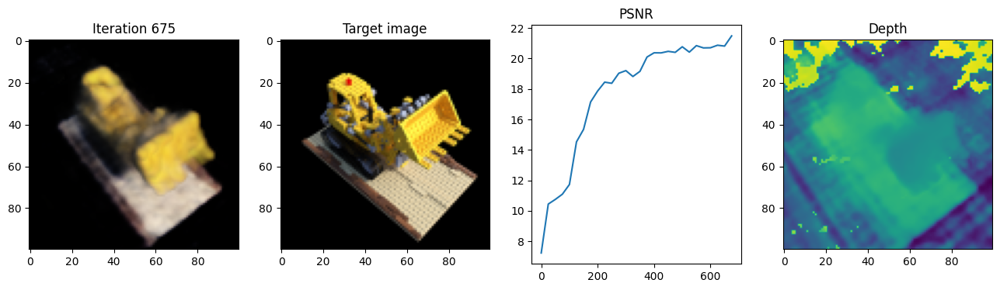

Iteration 700 | Loss: 0.0109 | PSNR: 20.99 | Time per iter: 0.34s | Total time: 4.00 min


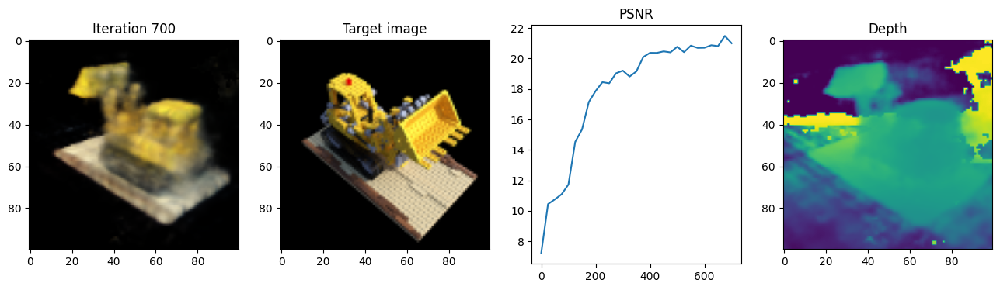

Iteration 725 | Loss: 0.0087 | PSNR: 21.57 | Time per iter: 0.34s | Total time: 4.14 min
PSNR imrpoved from 21.480215072631836 to 21.571758270263672
Saving model to nerf_model.pth


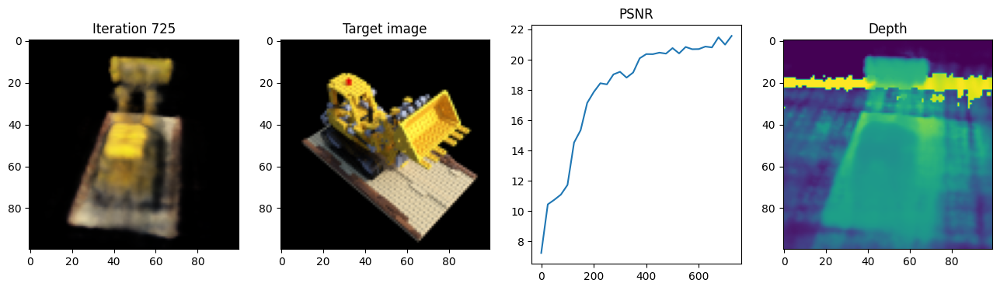

Iteration 750 | Loss: 0.0047 | PSNR: 21.77 | Time per iter: 0.34s | Total time: 4.28 min
PSNR imrpoved from 21.571758270263672 to 21.771007537841797
Saving model to nerf_model.pth


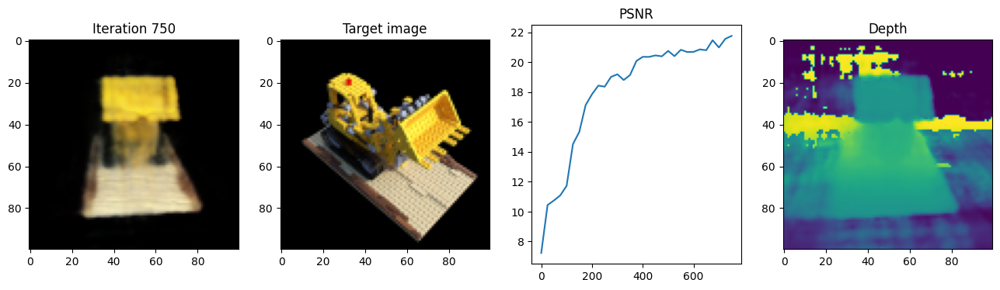

Iteration 775 | Loss: 0.0048 | PSNR: 21.30 | Time per iter: 0.34s | Total time: 4.42 min


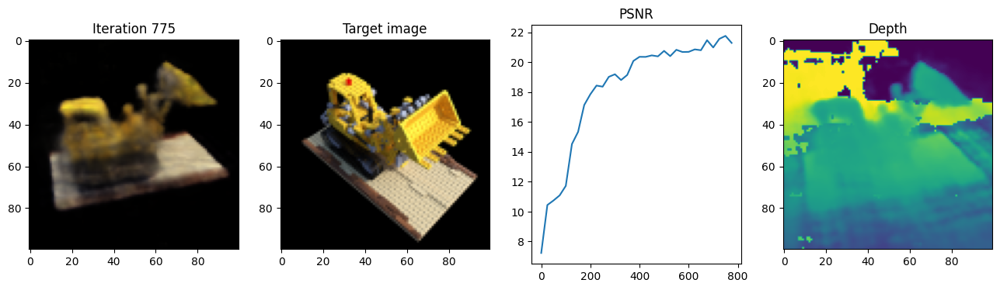

Iteration 800 | Loss: 0.0054 | PSNR: 21.63 | Time per iter: 0.33s | Total time: 4.56 min


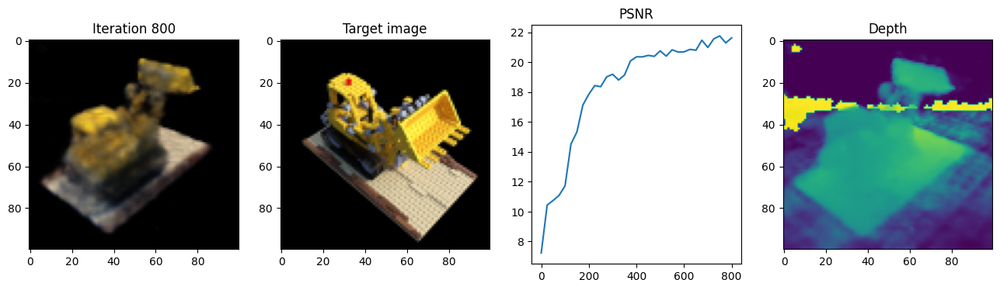

Iteration 825 | Loss: 0.0075 | PSNR: 21.28 | Time per iter: 0.34s | Total time: 4.70 min


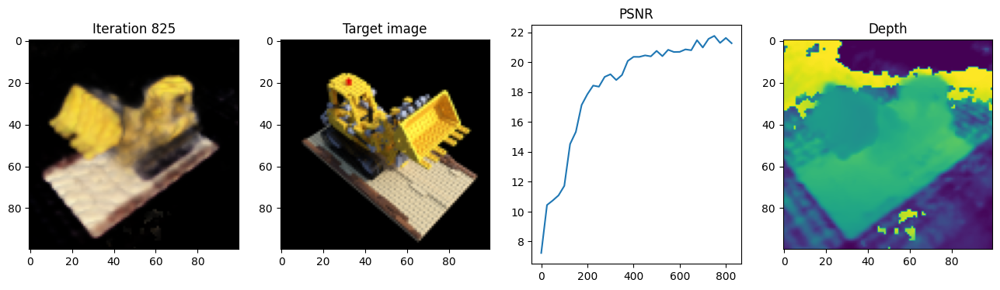

Iteration 850 | Loss: 0.0084 | PSNR: 22.00 | Time per iter: 0.34s | Total time: 4.84 min
PSNR imrpoved from 21.771007537841797 to 22.00498390197754
Saving model to nerf_model.pth


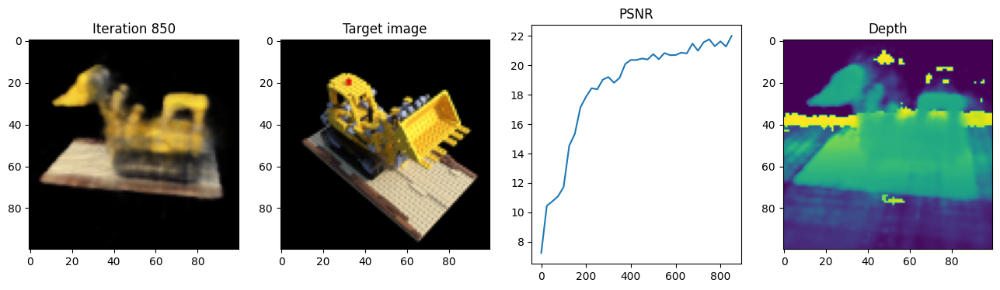

Iteration 875 | Loss: 0.0077 | PSNR: 21.23 | Time per iter: 0.34s | Total time: 4.98 min


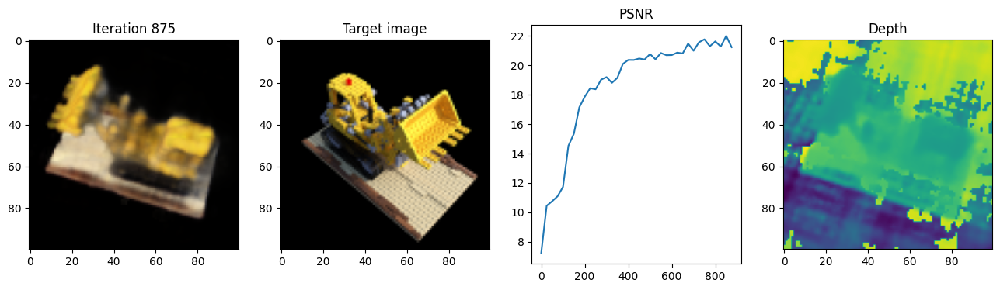

Iteration 900 | Loss: 0.0056 | PSNR: 21.77 | Time per iter: 0.34s | Total time: 5.12 min


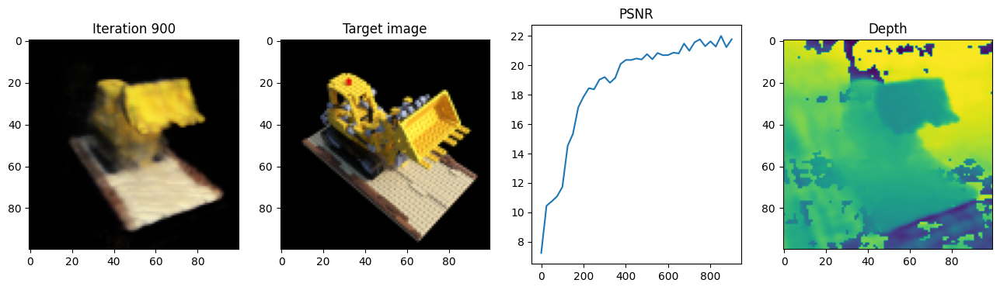

Iteration 925 | Loss: 0.0075 | PSNR: 21.69 | Time per iter: 0.33s | Total time: 5.26 min


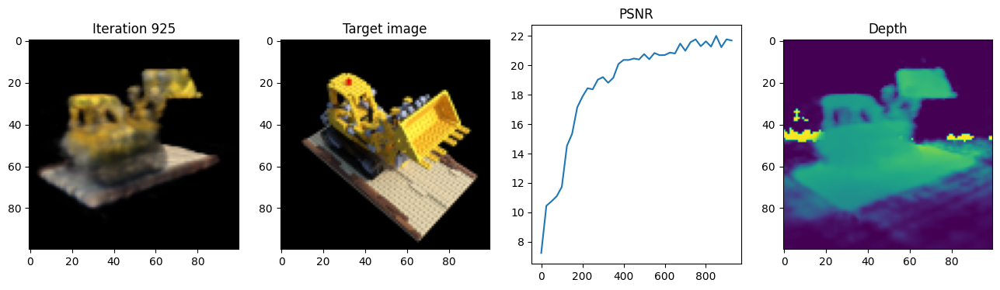

Iteration 950 | Loss: 0.0061 | PSNR: 21.79 | Time per iter: 0.33s | Total time: 5.40 min


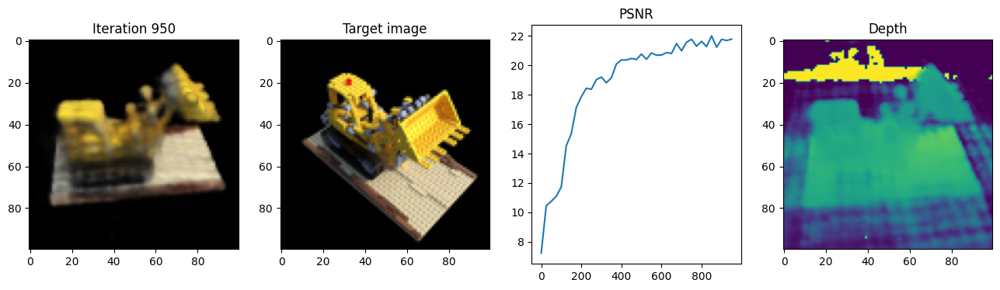

Iteration 975 | Loss: 0.0044 | PSNR: 21.41 | Time per iter: 0.33s | Total time: 5.54 min


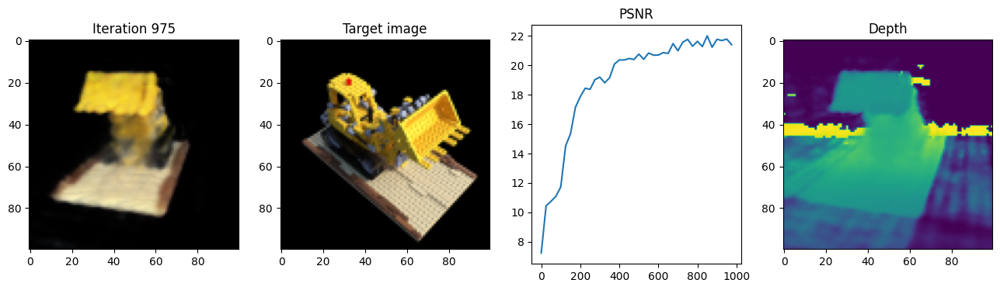

Iteration 1000 | Loss: 0.0067 | PSNR: 22.45 | Time per iter: 0.33s | Total time: 5.68 min
PSNR imrpoved from 22.00498390197754 to 22.448680877685547
Saving model to nerf_model.pth


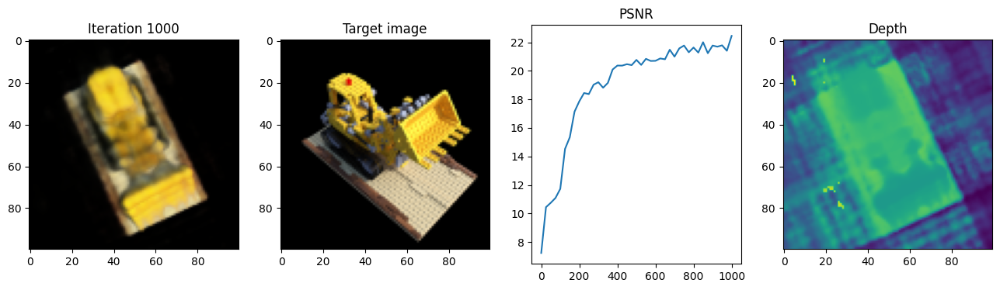

Iteration 1025 | Loss: 0.0074 | PSNR: 22.12 | Time per iter: 0.34s | Total time: 5.82 min


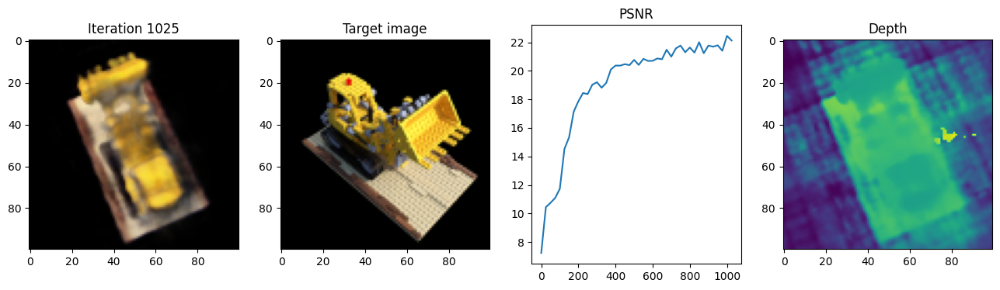

Iteration 1050 | Loss: 0.0053 | PSNR: 22.33 | Time per iter: 0.33s | Total time: 5.96 min


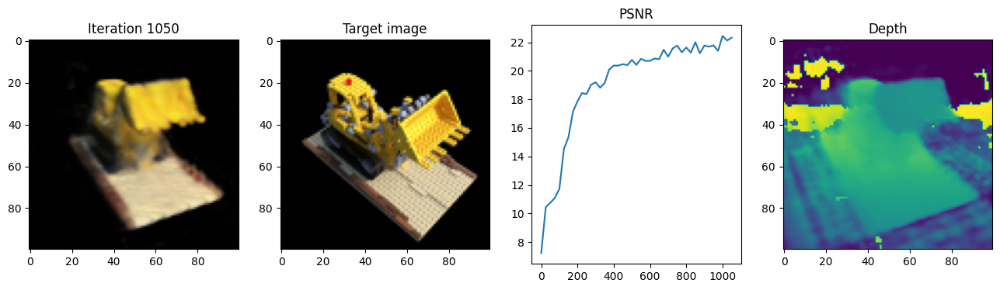

Iteration 1075 | Loss: 0.0064 | PSNR: 22.06 | Time per iter: 0.33s | Total time: 6.10 min


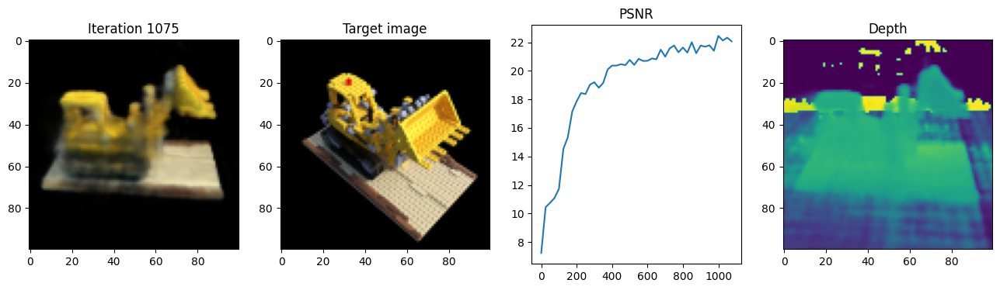

Iteration 1100 | Loss: 0.0051 | PSNR: 22.12 | Time per iter: 0.34s | Total time: 6.24 min


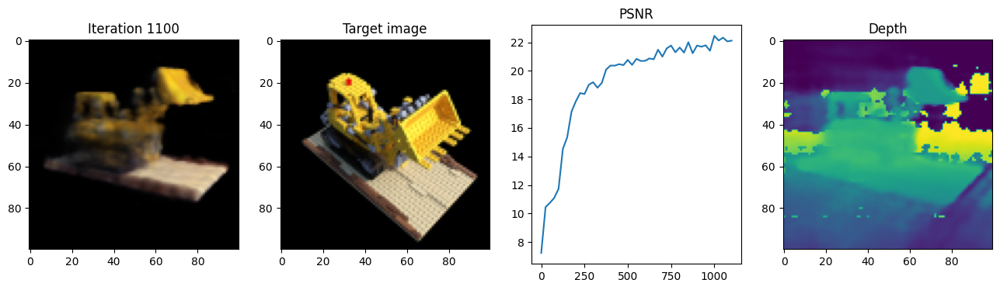

Iteration 1125 | Loss: 0.0049 | PSNR: 22.20 | Time per iter: 0.33s | Total time: 6.38 min


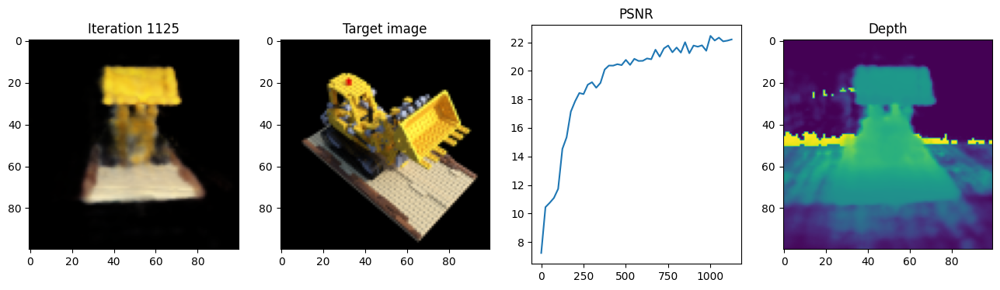

Iteration 1150 | Loss: 0.0066 | PSNR: 22.06 | Time per iter: 0.33s | Total time: 6.52 min


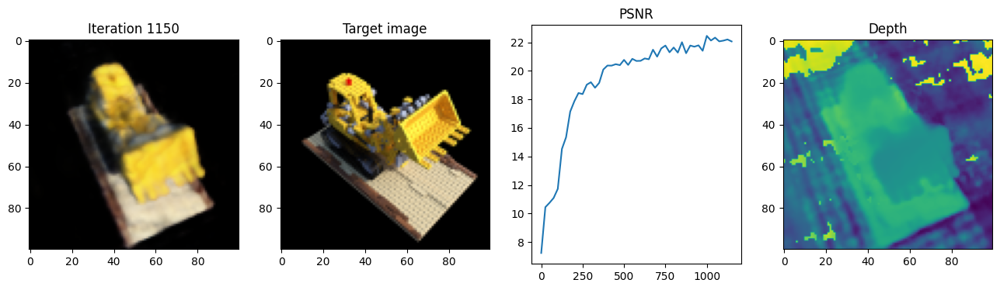

Iteration 1175 | Loss: 0.0060 | PSNR: 22.05 | Time per iter: 0.34s | Total time: 6.66 min


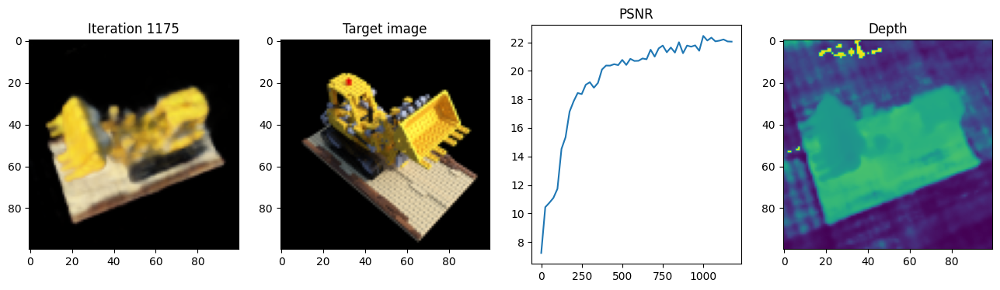

Iteration 1200 | Loss: 0.0048 | PSNR: 22.44 | Time per iter: 0.34s | Total time: 6.80 min


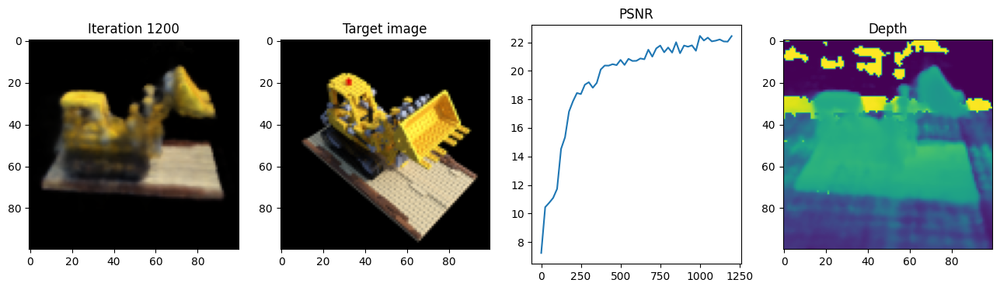

Iteration 1225 | Loss: 0.0060 | PSNR: 22.45 | Time per iter: 0.34s | Total time: 6.94 min
PSNR imrpoved from 22.448680877685547 to 22.44976234436035
Saving model to nerf_model.pth


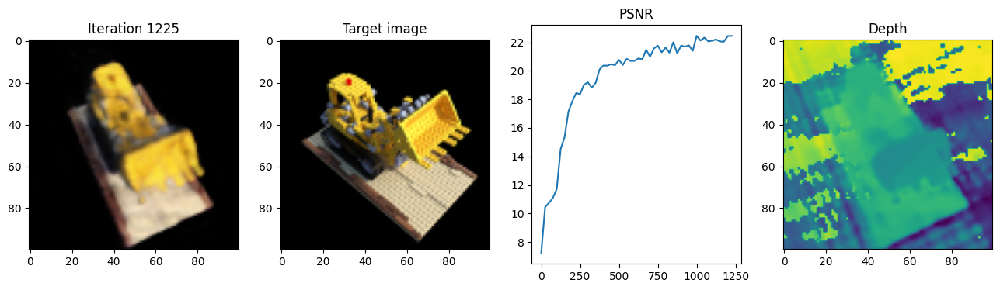

Iteration 1250 | Loss: 0.0060 | PSNR: 22.32 | Time per iter: 0.34s | Total time: 7.08 min


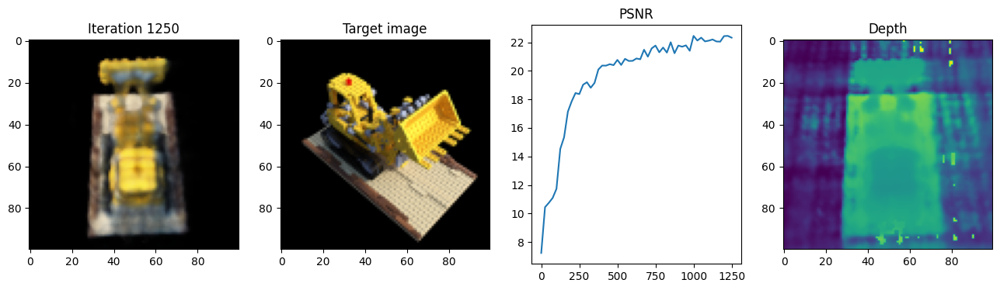

Iteration 1275 | Loss: 0.0059 | PSNR: 22.13 | Time per iter: 0.33s | Total time: 7.22 min


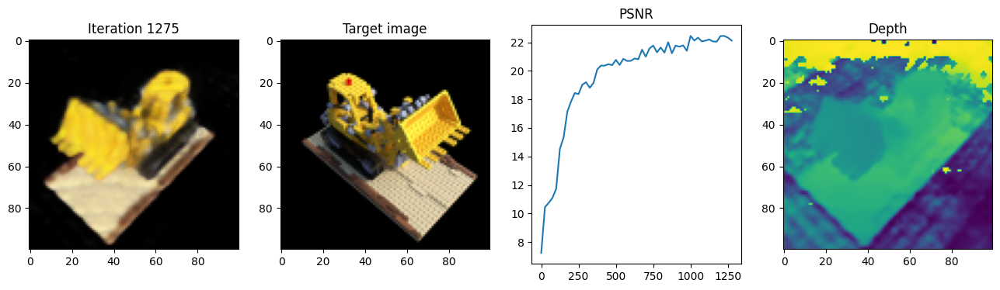

Iteration 1300 | Loss: 0.0038 | PSNR: 20.94 | Time per iter: 0.33s | Total time: 7.36 min


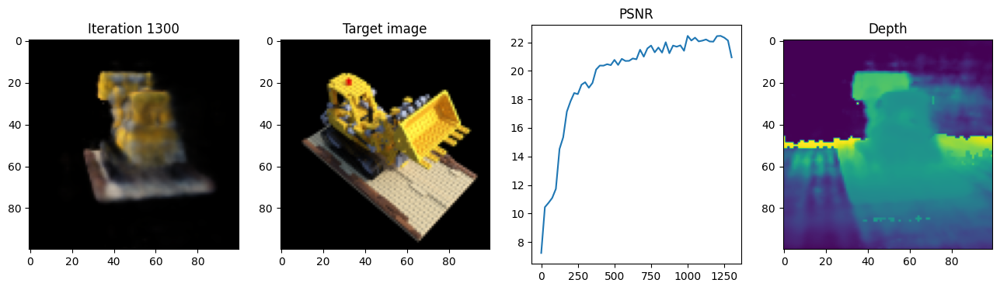

Iteration 1325 | Loss: 0.0035 | PSNR: 22.82 | Time per iter: 0.33s | Total time: 7.50 min
PSNR imrpoved from 22.44976234436035 to 22.822948455810547
Saving model to nerf_model.pth


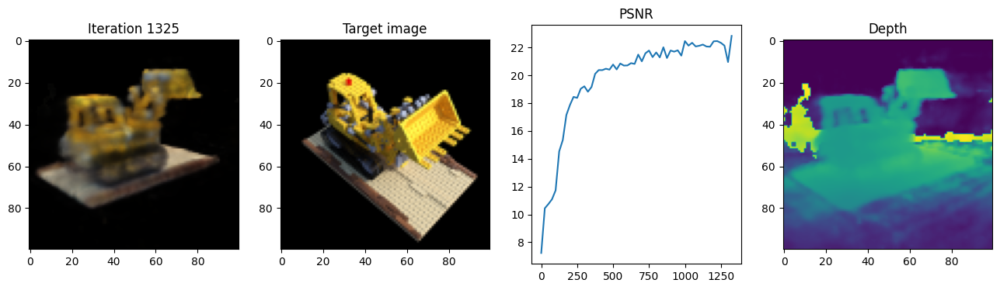

Iteration 1350 | Loss: 0.0051 | PSNR: 22.04 | Time per iter: 0.34s | Total time: 7.64 min


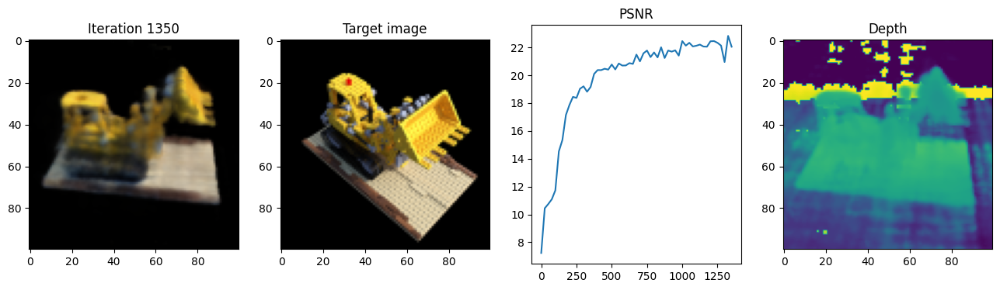

Iteration 1375 | Loss: 0.0035 | PSNR: 22.28 | Time per iter: 0.34s | Total time: 7.78 min


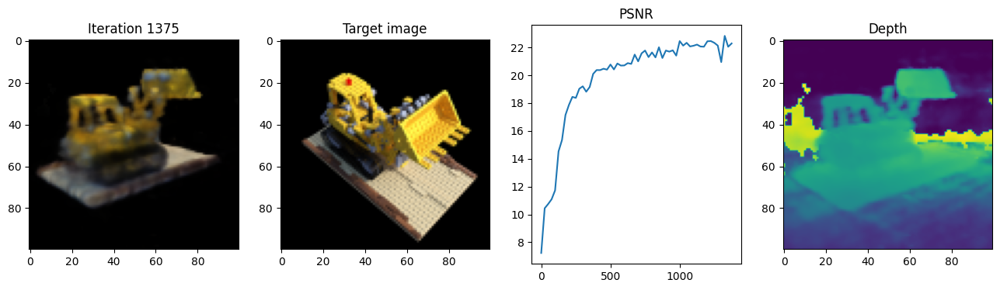

Iteration 1400 | Loss: 0.0056 | PSNR: 22.92 | Time per iter: 0.34s | Total time: 7.92 min
PSNR imrpoved from 22.822948455810547 to 22.915836334228516
Saving model to nerf_model.pth


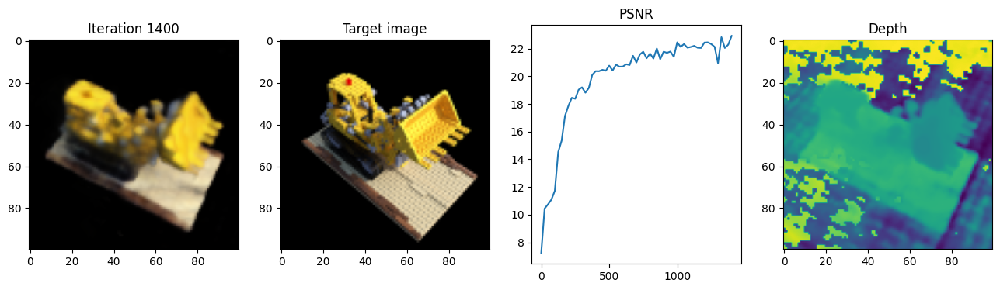

Iteration 1425 | Loss: 0.0045 | PSNR: 22.55 | Time per iter: 0.34s | Total time: 8.06 min


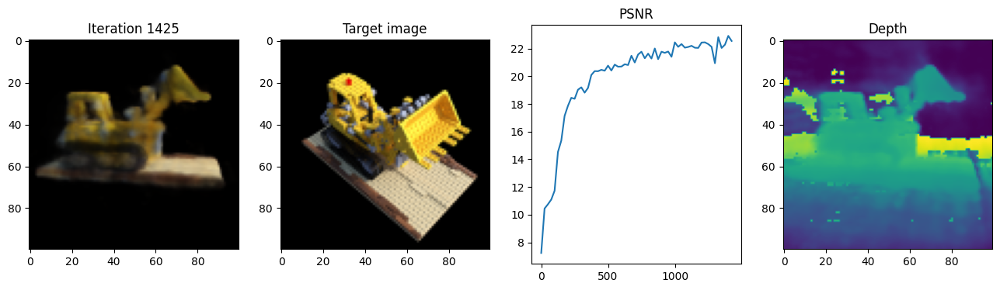

Iteration 1450 | Loss: 0.0071 | PSNR: 23.39 | Time per iter: 0.34s | Total time: 8.21 min
PSNR imrpoved from 22.915836334228516 to 23.386035919189453
Saving model to nerf_model.pth


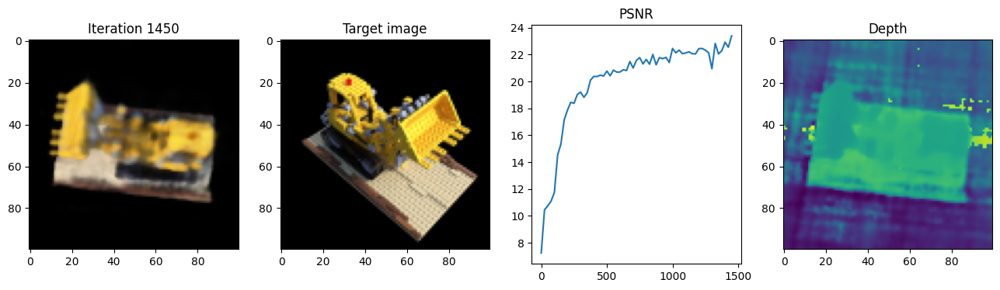

Iteration 1475 | Loss: 0.0053 | PSNR: 22.89 | Time per iter: 0.34s | Total time: 8.35 min


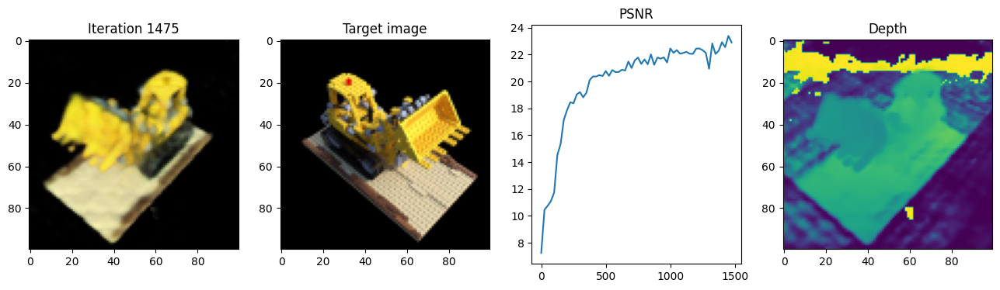

Iteration 1500 | Loss: 0.0074 | PSNR: 22.61 | Time per iter: 0.33s | Total time: 8.48 min


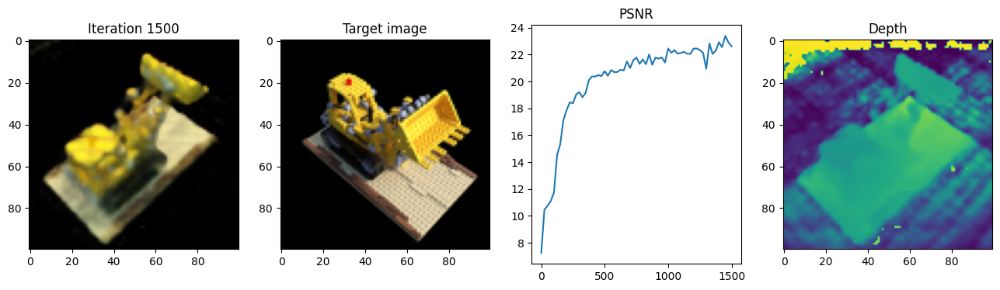

Iteration 1525 | Loss: 0.0063 | PSNR: 23.42 | Time per iter: 0.34s | Total time: 8.63 min
PSNR imrpoved from 23.386035919189453 to 23.416027069091797
Saving model to nerf_model.pth


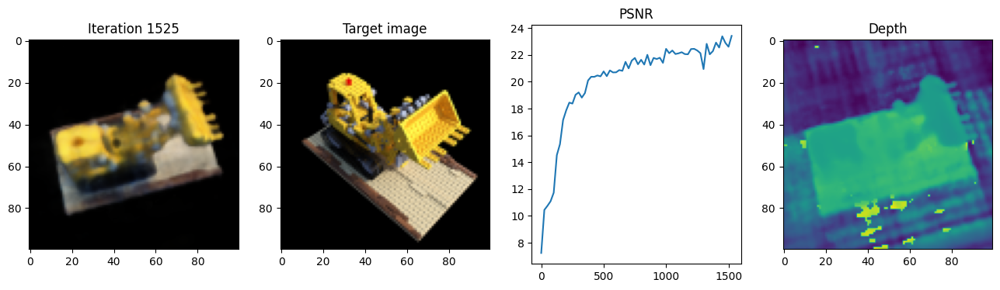

Iteration 1550 | Loss: 0.0073 | PSNR: 23.78 | Time per iter: 0.34s | Total time: 8.77 min
PSNR imrpoved from 23.416027069091797 to 23.77564239501953
Saving model to nerf_model.pth


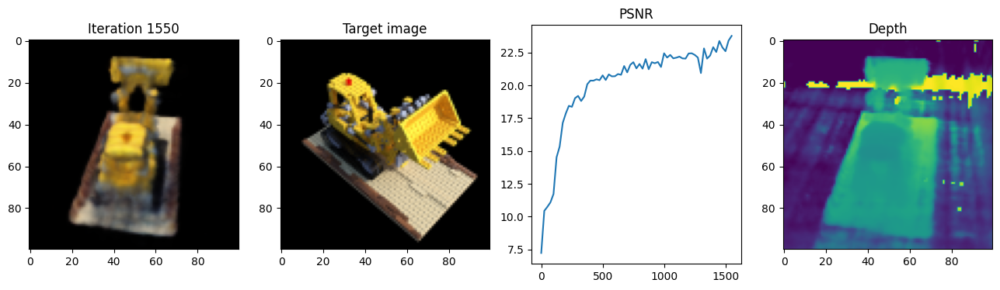

Iteration 1575 | Loss: 0.0059 | PSNR: 22.57 | Time per iter: 0.33s | Total time: 8.91 min


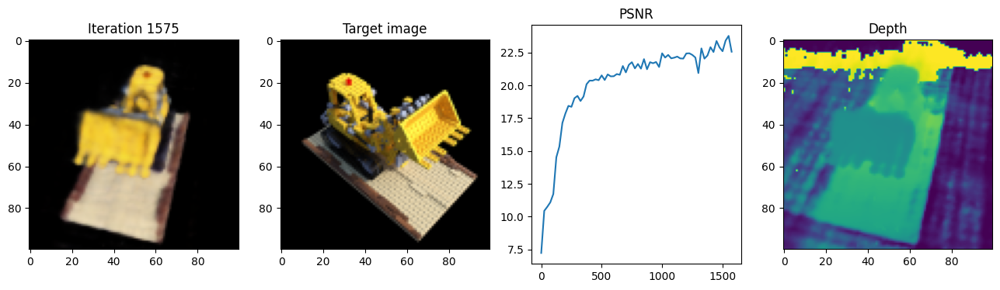

Iteration 1600 | Loss: 0.0065 | PSNR: 22.79 | Time per iter: 0.33s | Total time: 9.05 min


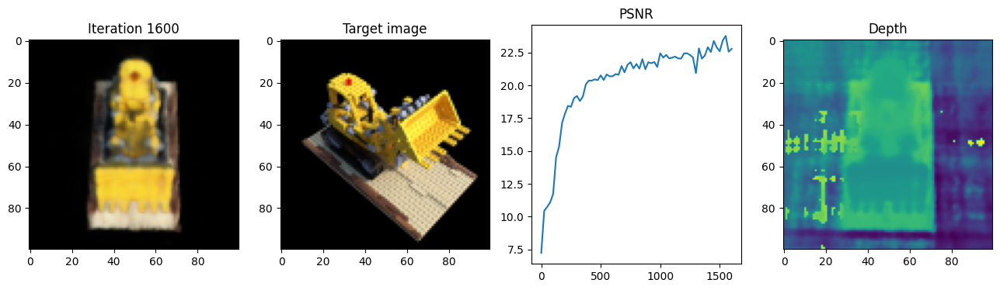

Iteration 1625 | Loss: 0.0034 | PSNR: 23.29 | Time per iter: 0.33s | Total time: 9.19 min


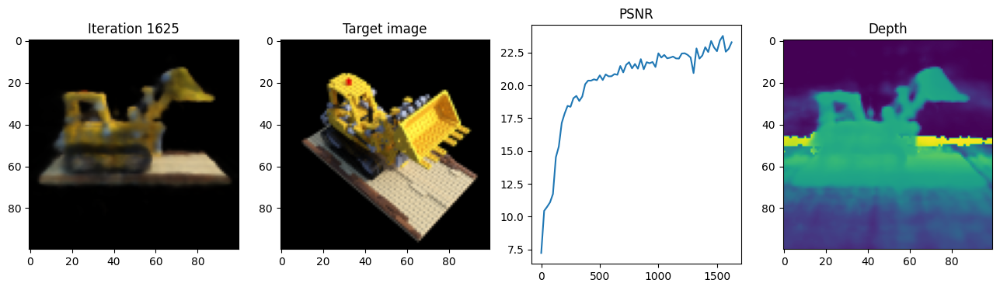

Iteration 1650 | Loss: 0.0065 | PSNR: 22.51 | Time per iter: 0.34s | Total time: 9.33 min


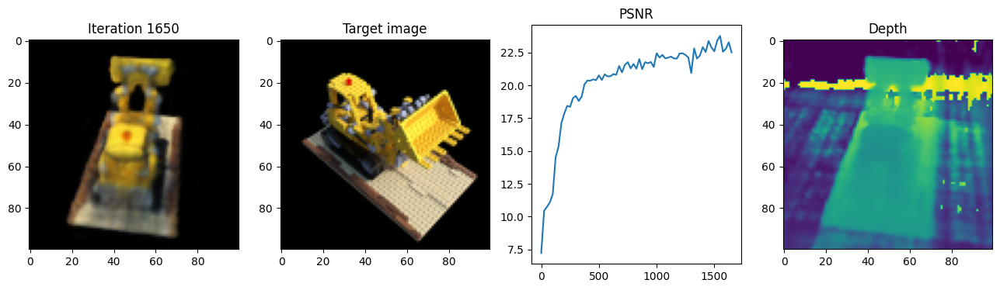

Iteration 1675 | Loss: 0.0056 | PSNR: 23.36 | Time per iter: 0.33s | Total time: 9.46 min


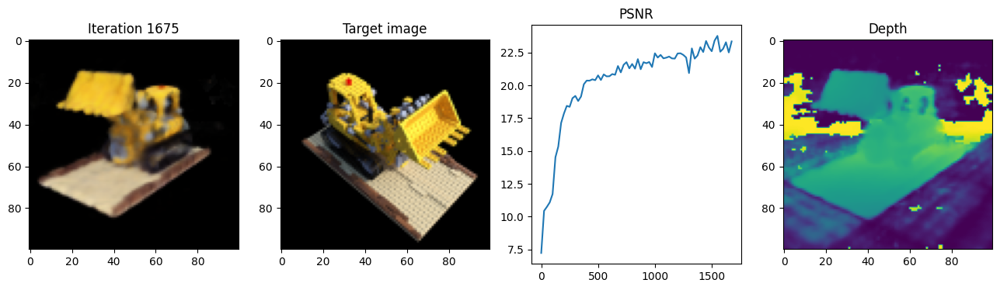

Iteration 1700 | Loss: 0.0040 | PSNR: 22.49 | Time per iter: 0.34s | Total time: 9.61 min


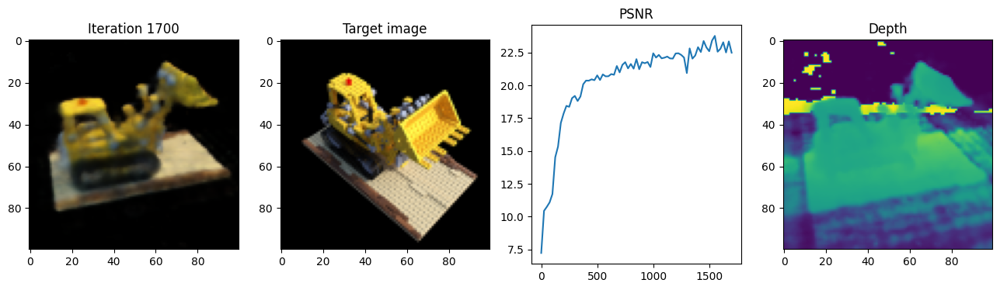

Iteration 1725 | Loss: 0.0046 | PSNR: 22.50 | Time per iter: 0.33s | Total time: 9.75 min


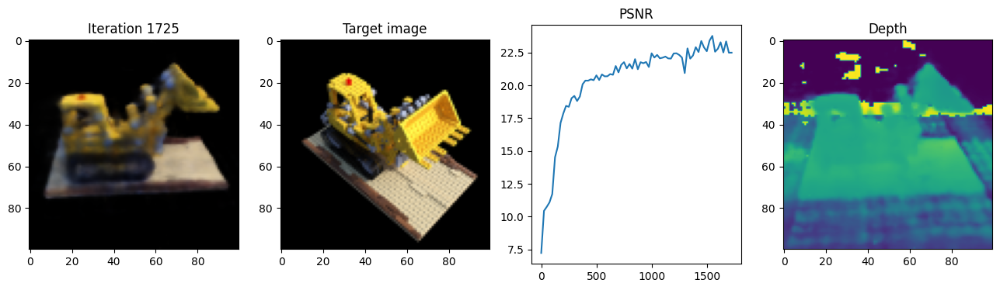

Iteration 1750 | Loss: 0.0055 | PSNR: 22.92 | Time per iter: 0.33s | Total time: 9.88 min


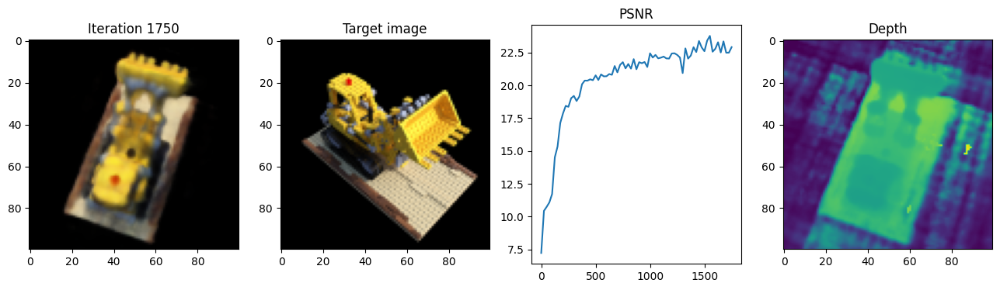

Iteration 1775 | Loss: 0.0023 | PSNR: 22.69 | Time per iter: 0.34s | Total time: 10.02 min


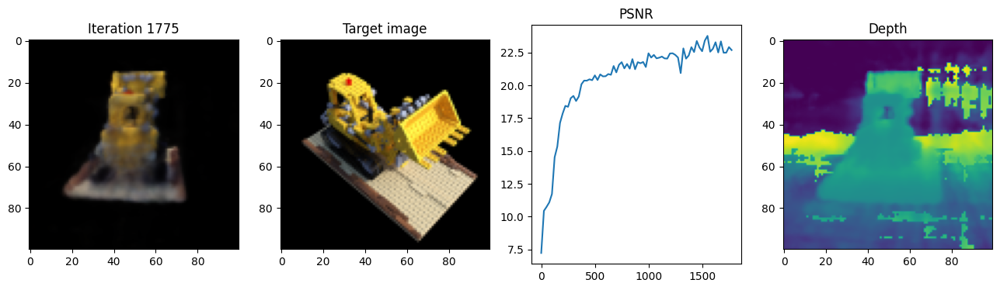

Iteration 1800 | Loss: 0.0055 | PSNR: 23.18 | Time per iter: 0.34s | Total time: 10.17 min


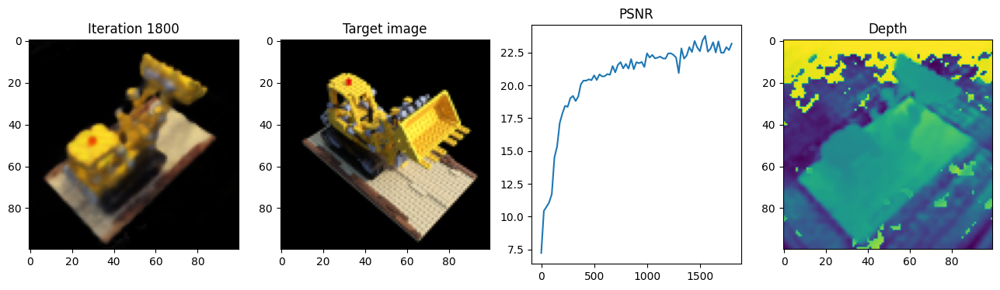

Iteration 1825 | Loss: 0.0052 | PSNR: 22.58 | Time per iter: 0.33s | Total time: 10.30 min


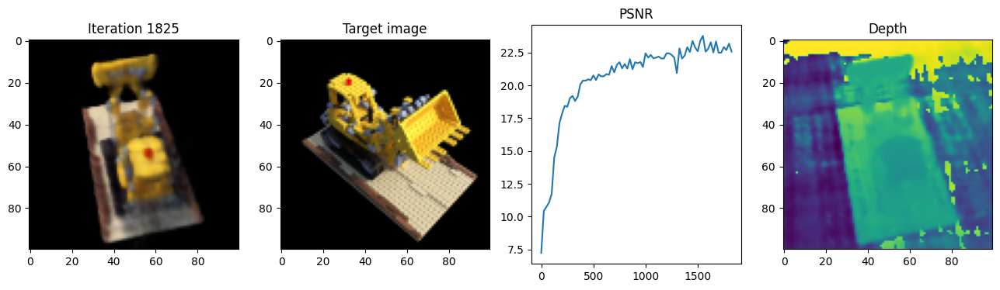

Iteration 1850 | Loss: 0.0056 | PSNR: 21.85 | Time per iter: 0.34s | Total time: 10.44 min


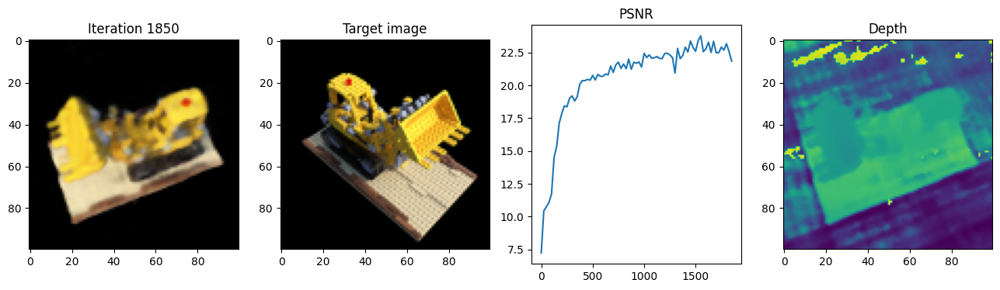

Iteration 1875 | Loss: 0.0057 | PSNR: 22.56 | Time per iter: 0.35s | Total time: 10.59 min


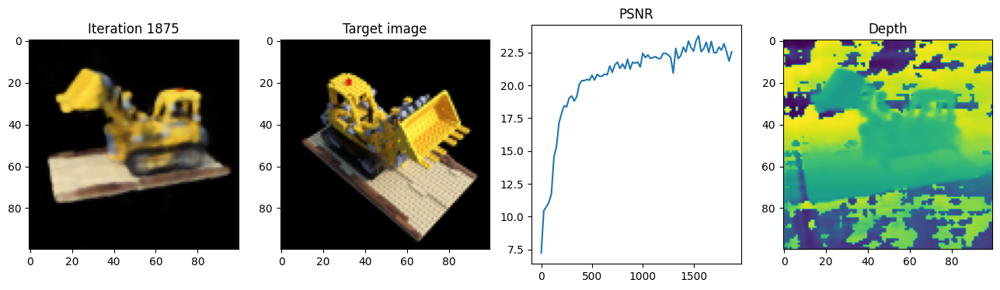

Iteration 1900 | Loss: 0.0047 | PSNR: 23.37 | Time per iter: 0.34s | Total time: 10.73 min


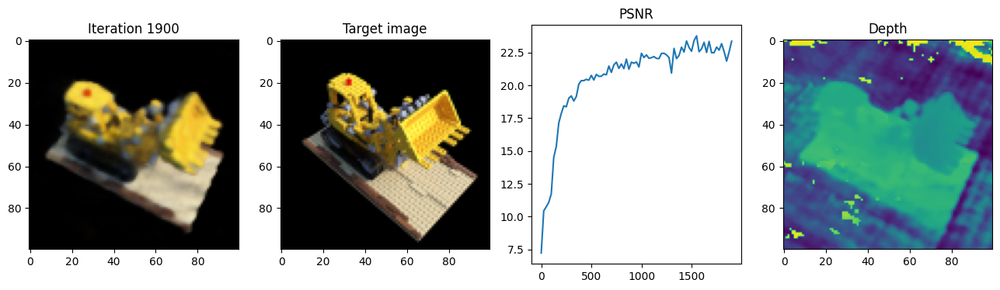

Iteration 1925 | Loss: 0.0053 | PSNR: 22.51 | Time per iter: 0.34s | Total time: 10.87 min


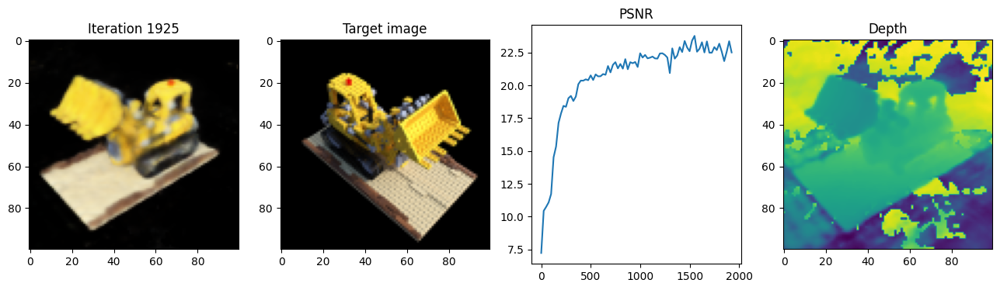

Iteration 1950 | Loss: 0.0036 | PSNR: 23.20 | Time per iter: 0.33s | Total time: 11.01 min


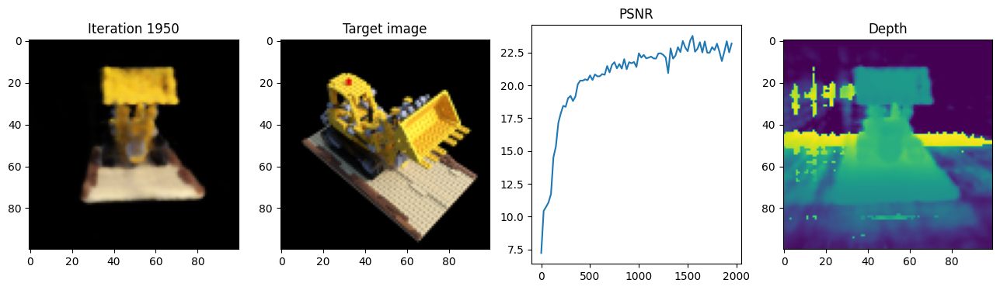

Iteration 1975 | Loss: 0.0036 | PSNR: 23.37 | Time per iter: 0.34s | Total time: 11.15 min


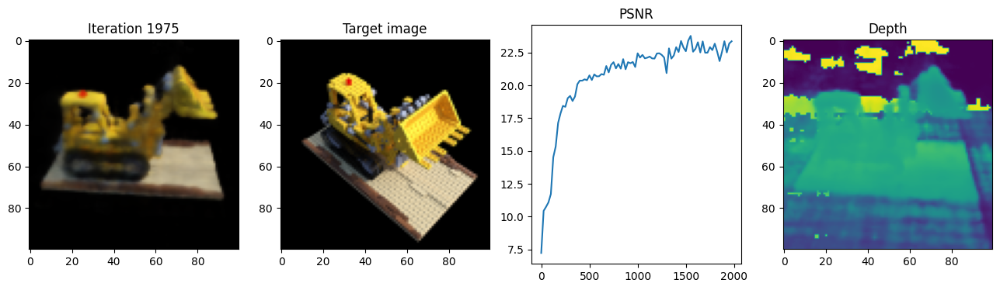

Iteration 2000 | Loss: 0.0031 | PSNR: 23.82 | Time per iter: 0.34s | Total time: 11.29 min
PSNR imrpoved from 23.77564239501953 to 23.824796676635742
Saving model to nerf_model.pth


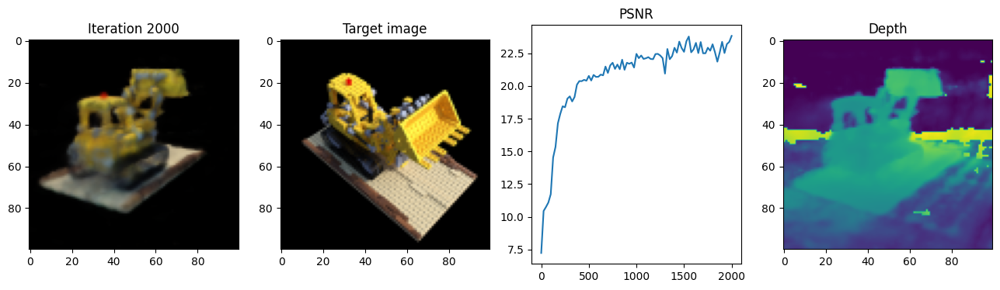

Training completed!


In [4]:
"""
Training NeRF
"""
import sys
sys.path.insert(0, 'src')
from vision.part3 import train_nerf

num_iters = 2000
depth_samples_per_ray = 64

model, encode = train_nerf(
    images, tform_cam2world, cam_intrinsics, testpose, testimg, height, width,
    near_thresh, far_thresh, device='cuda', num_frequencies=6,
    depth_samples_per_ray=depth_samples_per_ray, lr=5e-4, num_iters=num_iters, display_every=25
)

## Interactive visualization
Training finished!

In [5]:
from vision.part2 import render_image_nerf

trans_t = lambda t : np.array([
    [1,0,0,0],
    [0,1,0,0],
    [0,0,1,t],
    [0,0,0,1],
], dtype=np.float32)

rot_phi = lambda phi : np.array([
    [1,0,0,0],
    [0,np.cos(phi),-np.sin(phi),0],
    [0,np.sin(phi), np.cos(phi),0],
    [0,0,0,1],
], dtype=np.float32)

rot_theta = lambda th : np.array([
    [np.cos(th),0,-np.sin(th),0],
    [0,1,0,0],
    [np.sin(th),0, np.cos(th),0],
    [0,0,0,1],
], dtype=np.float32)


def pose_spherical(theta, phi, radius):
    c2w = trans_t(radius)
    c2w = rot_phi(phi/180.*np.pi) @ c2w
    c2w = rot_theta(theta/180.*np.pi) @ c2w
    c2w = np.array([[-1,0,0,0],[0,0,1,0],[0,1,0,0],[0,0,0,1]]) @ c2w
    c2w = c2w @ np.array([[1,0,0,0],[0,-1,0,0],[0,0,-1,0],[0,0,0,1]])
    c2w = np.array(c2w, dtype=np.float32)
    return c2w

%matplotlib inline
from ipywidgets import interactive, widgets
def f(**kwargs):
    render_poses = torch.from_numpy(pose_spherical(**kwargs)).to(device)
    rgb_predicted, _ = render_image_nerf(height, width, cam_intrinsics,
                                              render_poses[:3,:4], near_thresh,
                                              far_thresh, depth_samples_per_ray,
                                              encode, model)
    img = np.clip(rgb_predicted.detach().cpu().numpy(),0,1)

    plt.figure(2, figsize=(20,6))
    plt.imshow(img)
    plt.show()

sldr = lambda v, mi, ma: widgets.FloatSlider(
    value=v,
    min=mi,
    max=ma,
    step=.01,
)

names = [
    ['theta', [100., 0., 360]],
    ['phi', [-30., -90, 0]],
    ['radius', [1.5, 1., 2.]],
]

interactive_plot = interactive(f, **{s[0] : sldr(*s[1]) for s in names})
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=100.0, description='theta', max=360.0, step=0.01), FloatSlider(value=-…

## Qualitative evaluation
Create a 360 video with the trained NeRF by rendering a set of images around the object. Evaluate the novel view synthesis results qualitatively.
***Save your video and push the video to your github repository.***

In [6]:
import imageio
# 360 video
import tqdm

with torch.no_grad():
  rgbs = []
  for th in tqdm.tqdm(np.linspace(0., 360., 120, endpoint=False)):
      render_poses = torch.from_numpy(pose_spherical(th, -30., 1.4)).to(device)
      rgb_predicted, _ = render_image_nerf(height, width, cam_intrinsics,
                                              render_poses[:3,:4], near_thresh,
                                              far_thresh, depth_samples_per_ray,
                                              encode, model)
      rgbs.append(rgb_predicted.detach().cpu().numpy())
rgbs = np.array(rgbs)
print('Done, saving', rgbs.shape)
moviebase = os.path.join('{}_spiral_{:06d}_'.format("lego", num_iters))
to8b = lambda x : (255*np.clip(x,0,1)).astype(np.uint8)
imageio.mimwrite(moviebase + 'rgb.mp4', to8b(rgbs), fps=30, quality=8)

from IPython.display import HTML
from base64 import b64encode
mp4 = open(moviebase + 'rgb.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

100%|██████████| 120/120 [00:15<00:00,  7.82it/s]


Done, saving (120, 100, 100, 3)


## Quantitive results
Evaluate the novel view synthesis results quantitatively on the test set with PSNR metric. Expect to reach PSNR greater than or equal to 20.

In [7]:
psnrs = []
for i in range(testset.shape[0]):
  with torch.no_grad():
    rgb_predicted, depth_predicted = render_image_nerf(height, width, cam_intrinsics,
                                            testsetpose[i], near_thresh,
                                            far_thresh, depth_samples_per_ray,
                                            encode, model)
  loss = F.mse_loss(rgb_predicted, testset[i])
  psnr = -10. * torch.log10(loss)
  psnrs.append(psnr.item())
print("PSNR on test set: %.2f" % np.mean(np.array(psnrs)))

PSNR on test set: 25.15


### Don't forget to download nerf_model.pth from colab and put it in the output/ directory in your local project folder before you zip for submission!